# US Accidents (2016 - 2023)

## A Countrywide Traffic Accident Dataset (2016 - 2023)

This is a countrywide car accident dataset that covers 49 states of the USA. The accident data were collected from February 2016 to March 2023, using multiple APIs that provide streaming traffic incident (or event) data. These APIs broadcast traffic data captured by various entities, including the US and state departments of transportation, law enforcement agencies, traffic cameras, and traffic sensors within the road networks. The dataset currently contains approximately 7.7 million accident records. For more information about this dataset, please visit here.

## EDA

In [1]:
#import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

#supress warnings
import warnings
warnings.filterwarnings("ignore")

%matplotlib inline

In [2]:
accident_data = pd.read_csv('./input/US_Accidents_March23.csv')
accident_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7728394 entries, 0 to 7728393
Data columns (total 46 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   ID                     object 
 1   Source                 object 
 2   Severity               int64  
 3   Start_Time             object 
 4   End_Time               object 
 5   Start_Lat              float64
 6   Start_Lng              float64
 7   End_Lat                float64
 8   End_Lng                float64
 9   Distance(mi)           float64
 10  Description            object 
 11  Street                 object 
 12  City                   object 
 13  County                 object 
 14  State                  object 
 15  Zipcode                object 
 16  Country                object 
 17  Timezone               object 
 18  Airport_Code           object 
 19  Weather_Timestamp      object 
 20  Temperature(F)         float64
 21  Wind_Chill(F)          float64
 22  Humidity(%)       

In [3]:
accident_data.Start_Time = pd.to_datetime(accident_data.Start_Time, format='ISO8601')
accident_data.End_Time = pd.to_datetime(accident_data.End_Time, format='ISO8601')

In [109]:
# extract Southwestern Pennsylvania data
accidents_PA = accident_data[accident_data['State'] == 'PA']
accidents_SWPA = accidents_PA[accidents_PA['County'].isin(['Allegheny','Armstrong','Beaver','Butler','Fayette','Greene','Indiana','Lawrence','Washington','Westmoreland'])]
#look at formatting of entries
accidents_SWPA.head()

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
228582,A-228589,Source2,3,2016-11-30 18:03:36,2016-11-30 18:33:11,40.423325,-80.105881,NaN,NaN,0.01,...,False,False,False,False,False,False,Night,Night,Night,Day
228591,A-228598,Source2,2,2016-11-30 19:15:33,2016-11-30 19:45:06,40.272663,-79.098083,NaN,NaN,2.21,...,False,False,False,False,False,False,Night,Night,Night,Night
228619,A-228626,Source2,3,2016-11-30 20:35:53,2016-11-30 21:05:08,40.678978,-80.104080,NaN,NaN,15.61,...,False,False,False,False,False,False,Night,Night,Night,Night
228631,A-228638,Source2,3,2016-12-01 05:21:00,2016-12-01 05:49:32,40.586620,-80.099976,NaN,NaN,4.70,...,False,False,False,False,False,False,Night,Night,Night,Night
228651,A-228658,Source2,2,2016-12-01 06:30:39,2016-12-01 07:00:18,40.477070,-79.999542,NaN,NaN,0.00,...,False,False,False,False,False,False,Night,Night,Day,Day


In [5]:
#looking to see ID format towards end
accidents_SWPA.tail()

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
7722368,A-7771736,Source1,4,2019-08-11 08:18:56,2019-08-11 08:48:10,40.383240,-80.193740,40.364703,-80.182025,1.422,...,False,False,False,False,False,False,Day,Day,Day,Day
7722369,A-7771737,Source1,4,2019-08-11 08:18:56,2019-08-11 08:48:10,40.364703,-80.182025,40.383240,-80.193740,1.422,...,False,False,False,False,False,False,Day,Day,Day,Day
7725867,A-7775235,Source1,3,2019-08-19 11:06:07,2019-08-19 11:32:17,39.869138,-79.957417,39.865236,-79.955194,0.294,...,False,False,False,False,False,False,Day,Day,Day,Day
7726388,A-7775756,Source1,4,2019-08-20 10:57:28,2019-08-20 11:23:27,40.428902,-79.932398,40.428800,-79.888640,2.301,...,False,False,True,False,False,False,Day,Day,Day,Day
7727994,A-7777362,Source1,4,2019-08-23 03:34:00,2019-08-23 04:02:31,40.462770,-79.981340,40.467520,-79.977490,0.386,...,False,False,False,False,False,False,Night,Night,Night,Night


In [6]:
#look at dtype
accidents_SWPA.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32819 entries, 228582 to 7727994
Data columns (total 46 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   ID                     32819 non-null  object 
 1   Source                 32819 non-null  object 
 2   Severity               32819 non-null  int64  
 3   Start_Time             32819 non-null  object 
 4   End_Time               32819 non-null  object 
 5   Start_Lat              32819 non-null  float64
 6   Start_Lng              32819 non-null  float64
 7   End_Lat                20026 non-null  float64
 8   End_Lng                20026 non-null  float64
 9   Distance(mi)           32819 non-null  float64
 10  Description            32819 non-null  object 
 11  Street                 32754 non-null  object 
 12  City                   32819 non-null  object 
 13  County                 32819 non-null  object 
 14  State                  32819 non-null  object 
 15  

In [7]:
#look at distribution of data
accidents_SWPA.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,32819.000000,32819.000000,32819.000000,20026.000000,20026.000000,32819.000000,32554.000000,26889.000000,32533.000000,32526.000000,32598.000000,31356.000000,24611.000000
mean,2.412596,40.431895,-79.917581,40.423934,-79.897670,1.049491,51.492047,45.908535,71.165801,29.099259,8.872652,7.799133,0.008300
std,0.694783,0.200756,0.265274,0.221306,0.297345,3.053241,19.322123,22.831749,19.411864,0.688806,3.281679,4.762934,0.116289
min,1.000000,39.721318,-80.519229,39.715931,-80.571730,0.000000,-7.100000,-35.000000,12.000000,26.660000,0.000000,0.000000,0.000000
25%,2.000000,40.348306,-80.078415,40.310514,-80.086723,0.000000,35.000000,27.000000,57.000000,28.650000,9.000000,5.000000,0.000000
50%,2.000000,40.431034,-79.970151,40.428720,-79.955517,0.227000,52.000000,45.000000,74.000000,28.820000,10.000000,7.000000,0.000000
75%,3.000000,40.495342,-79.802402,40.496021,-79.728178,0.948000,68.000000,66.000000,87.000000,29.830000,10.000000,10.000000,0.000000
max,4.000000,41.172124,-78.777080,41.191164,-78.261710,138.910004,94.000000,94.000000,100.000000,56.540000,20.000000,44.000000,9.990000


In [8]:
#print number and percentage of null entries per variable
print('Null values per variable')
for column in accidents_SWPA.columns:
    print('{}: {} ({}%)'.format(column,pd.isnull(accidents_SWPA[column]).sum(),(pd.isnull(accidents_SWPA[column]).sum()/len(accidents_SWPA))*100))

Null values per variable
ID: 0 (0.0%)
Source: 0 (0.0%)
Severity: 0 (0.0%)
Start_Time: 0 (0.0%)
End_Time: 0 (0.0%)
Start_Lat: 0 (0.0%)
Start_Lng: 0 (0.0%)
End_Lat: 12793 (38.98046863097596%)
End_Lng: 12793 (38.98046863097596%)
Distance(mi): 0 (0.0%)
Description: 0 (0.0%)
Street: 65 (0.19805600414394103%)
City: 0 (0.0%)
County: 0 (0.0%)
State: 0 (0.0%)
Zipcode: 0 (0.0%)
Country: 0 (0.0%)
Timezone: 0 (0.0%)
Airport_Code: 54 (0.16453883421188947%)
Weather_Timestamp: 136 (0.414394100978092%)
Temperature(F): 265 (0.8074590938176057%)
Wind_Chill(F): 5930 (18.068801608824156%)
Humidity(%): 286 (0.8714464182333406%)
Pressure(in): 293 (0.8927755263719188%)
Visibility(mi): 221 (0.6733904140893994%)
Wind_Direction: 294 (0.895822541820287%)
Wind_Speed(mph): 1463 (4.457783600962857%)
Precipitation(in): 8208 (25.009902800207197%)
Weather_Condition: 182 (0.5545568116030348%)
Amenity: 0 (0.0%)
Bump: 0 (0.0%)
Crossing: 0 (0.0%)
Give_Way: 0 (0.0%)
Junction: 0 (0.0%)
No_Exit: 0 (0.0%)
Railway: 0 (0.0%)
Ro

### Insight-1: Among 32021 entries, 865 accidents having same start lat/long and end lat/long

In [9]:
#checking to see if the missing end lat/long are due having same start lat/long
accidents_SWPA[(accidents_SWPA.Start_Lat == accidents_SWPA.End_Lat) & (accidents_SWPA.Start_Lng == accidents_SWPA.End_Lng)]

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
3402877,A-3412760,Source1,2,2016-02-11 13:30:58,2016-02-11 19:30:58,40.589190,-80.098850,40.589190,-80.098850,0.0,...,False,False,False,False,False,False,Day,Day,Day,Day
3402883,A-3412766,Source1,2,2016-02-11 16:56:28,2016-02-11 22:56:28,40.589190,-80.098850,40.589190,-80.098850,0.0,...,False,False,False,False,False,False,Day,Day,Day,Day
3402917,A-3412800,Source1,3,2016-02-13 18:48:40,2016-02-14 00:48:40,40.530240,-80.009570,40.530240,-80.009570,0.0,...,False,True,False,False,True,False,Night,Night,Day,Day
3402918,A-3412801,Source1,3,2016-02-13 18:48:40,2016-02-14 00:48:40,40.530240,-80.009570,40.530240,-80.009570,0.0,...,False,True,False,False,True,False,Night,Night,Day,Day
3403129,A-3413012,Source1,2,2016-02-22 09:29:41,2016-02-22 15:29:41,40.430770,-80.026380,40.430770,-80.026380,0.0,...,False,False,False,False,False,False,Day,Day,Day,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7653346,A-7702714,Source1,2,2019-04-03 11:54:48,2019-04-03 12:23:07,40.664970,-80.241700,40.664970,-80.241700,0.0,...,False,False,False,False,False,False,Day,Day,Day,Day
7653347,A-7702715,Source1,4,2019-04-03 07:38:17,2019-04-03 08:07:02,40.491567,-79.865715,40.491567,-79.865715,0.0,...,False,False,False,False,True,False,Day,Day,Day,Day
7653348,A-7702716,Source1,4,2019-04-03 07:38:17,2019-04-03 08:07:02,40.491567,-79.865715,40.491567,-79.865715,0.0,...,False,False,False,False,True,False,Day,Day,Day,Day
7668742,A-7718110,Source1,3,2019-05-05 08:47:44,2019-05-05 09:17:04,40.400600,-79.554990,40.400600,-79.554990,0.0,...,False,False,True,False,False,False,Day,Day,Day,Day


### Insight-2: All records that are missing an airport_code are also missing weather information

In [10]:
weather_info = accidents_SWPA[accident_data.Airport_Code.isna()][['Airport_Code','Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)','Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition']]
print('Percentage null when Airport_Code is null:')
for weather in weather_info.columns:
    print('{}: {}%'.format(weather, (weather_info[weather].isna().count()/weather_info.Airport_Code.isna().count())*100))

Percentage null when Airport_Code is null:
Airport_Code: 100.0%
Weather_Timestamp: 100.0%
Temperature(F): 100.0%
Wind_Chill(F): 100.0%
Humidity(%): 100.0%
Pressure(in): 100.0%
Visibility(mi): 100.0%
Wind_Direction: 100.0%
Wind_Speed(mph): 100.0%
Precipitation(in): 100.0%
Weather_Condition: 100.0%


### Insight-3: Top5 Weather Condition for accidents

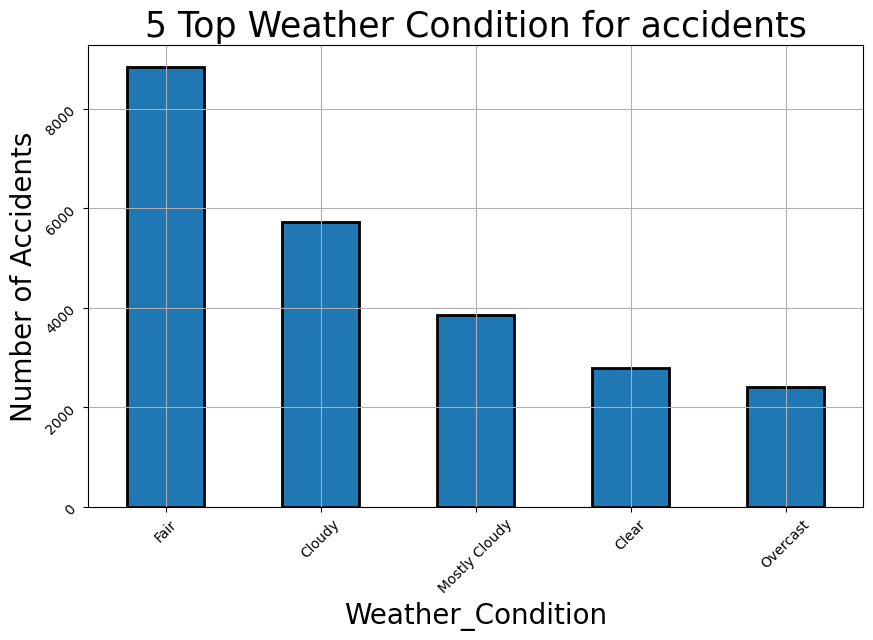

In [11]:
fig, ax=plt.subplots(figsize=(10,6))
accidents_SWPA['Weather_Condition'].value_counts().sort_values(ascending=False).head(5).plot.bar(width=0.5,edgecolor='k',align='center',linewidth=2)
plt.xlabel('Weather_Condition',fontsize=20)
plt.ylabel('Number of Accidents',fontsize=20)
ax.tick_params(labelsize=10, rotation=45)
plt.title('5 Top Weather Condition for accidents',fontsize=25)
plt.grid()
plt.ioff()

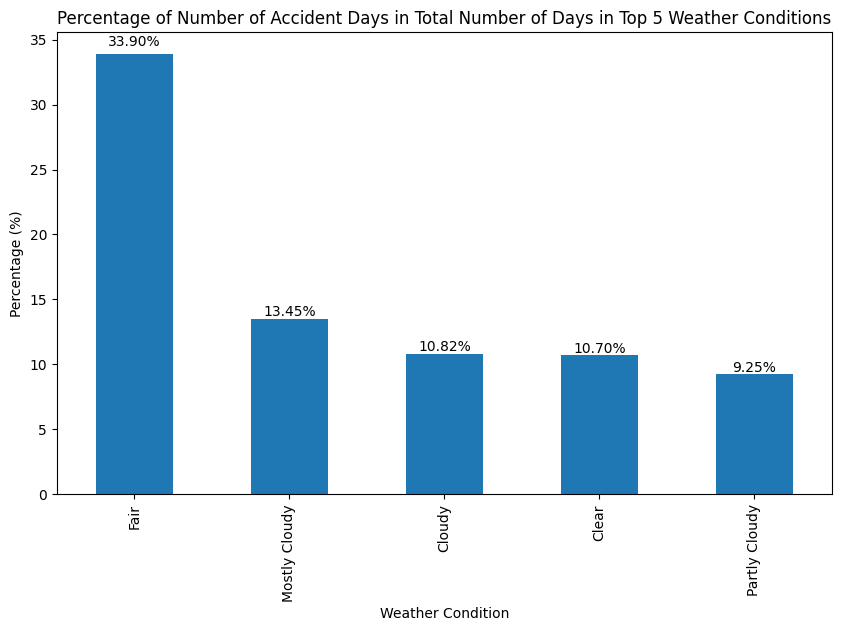

In [16]:
accident_days = accident_data['Weather_Condition'].value_counts()
top5_weather = accident_days.index[:5]
percentage = (accident_days[top5_weather] / accident_days.sum()) * 100
ax = percentage.plot(kind='bar', figsize=(10, 6))
plt.title('Percentage of Number of Accident Days in Total Number of Days in Top 5 Weather Conditions')
plt.xlabel('Weather Condition')
plt.ylabel('Percentage (%)')
for p in ax.patches:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy() 
    ax.annotate(f'{height:.2f}%', (x + width/2, y + height*1.02), ha='center')
plt.show()

### Insight-4: Top 10 Accident Prone Streets in Southwest Pennsylvania

In [43]:
# create a dataframe of Street and their corresponding accident cases
street_df = pd.DataFrame(accidents_SWPA['Street'].value_counts()).reset_index().rename(columns={'Cases':'Street', 'count':'Cases'})
top_ten_streets_df = pd.DataFrame(street_df.head(10))

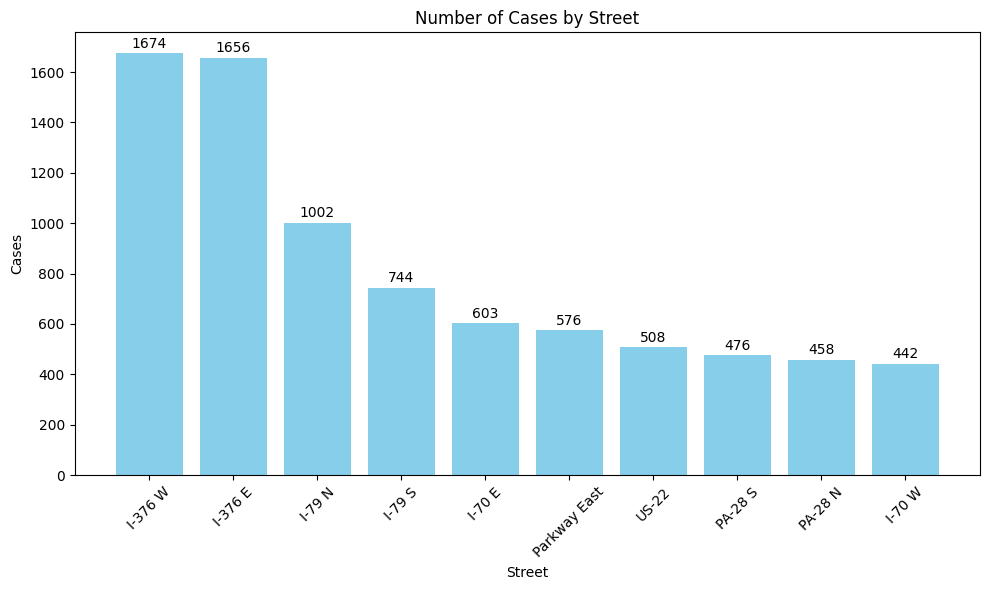

In [44]:
plt.figure(figsize=(10, 6))
plt.bar(top_ten_streets_df['Street'], top_ten_streets_df['Cases'], color='skyblue')
plt.xlabel('Street')
plt.ylabel('Cases')
plt.title('Number of Cases by Street')
plt.xticks(rotation=45)
plt.tight_layout()
bars = plt.bar(top_ten_streets_df['Street'], top_ten_streets_df['Cases'], color='skyblue')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 10, yval, ha='center', va='bottom')
plt.show()

In [45]:
accidents_SWPA.Start_Time = pd.to_datetime(accidents_SWPA.Start_Time, format="ISO8601")
year_df = pd.DataFrame(accidents_SWPA.Start_Time.dt.year.value_counts()).reset_index().rename(columns={'Start_Time':'Year', 'count':'Cases'}).sort_values(by='Cases')

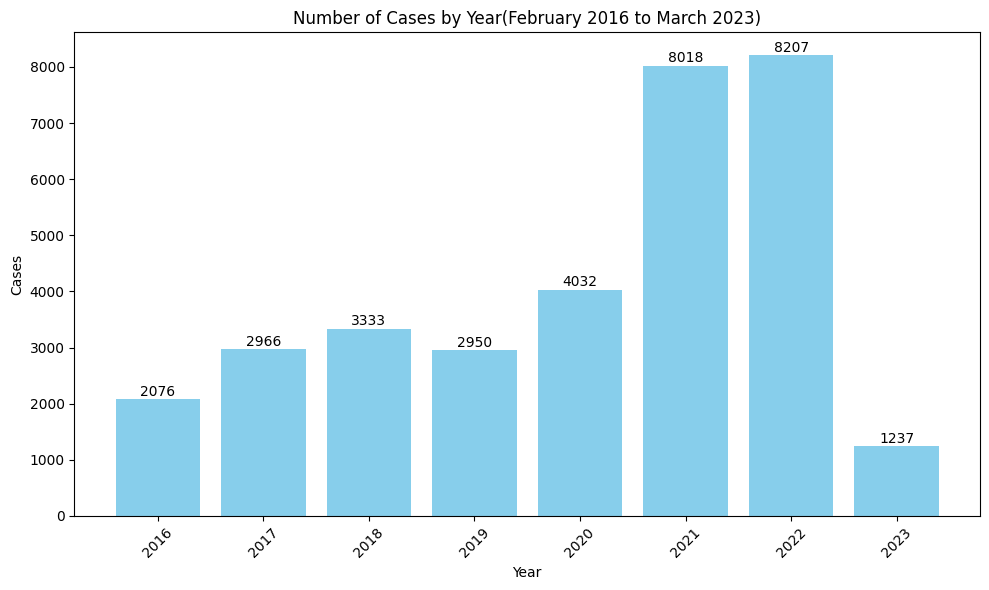

In [46]:
plt.figure(figsize=(10, 6))
plt.bar(year_df['Year'], year_df['Cases'], color='skyblue')
plt.xlabel('Year')
plt.ylabel('Cases')
plt.title('Number of Cases by Year(February 2016 to March 2023)')
plt.xticks(rotation=45)
plt.tight_layout()
bars = plt.bar(year_df['Year'], year_df['Cases'], color='skyblue')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 10, yval, ha='center', va='bottom')
plt.show()

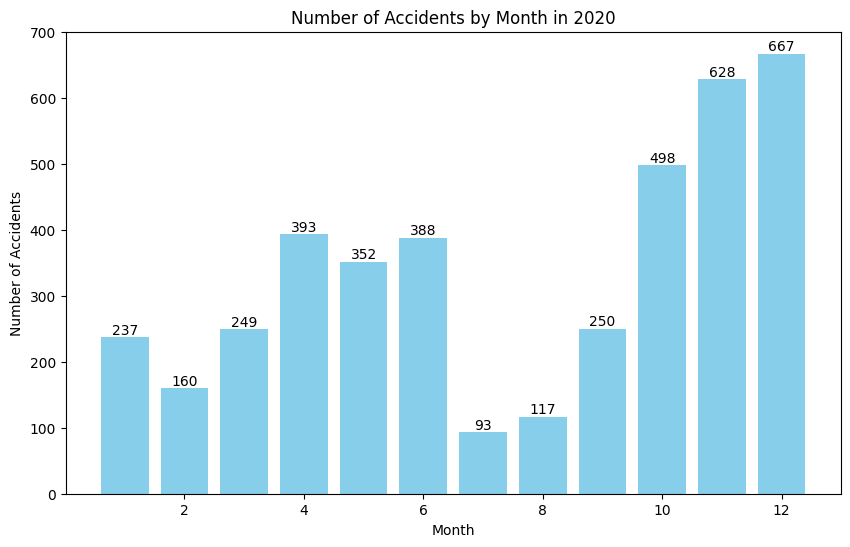

In [29]:
accidents_SWPA.Start_Time = pd.to_datetime(accidents_SWPA.Start_Time, format="ISO8601")
accidents_SWPA['Year'] = accidents_SWPA['Start_Time'].dt.year
accidents_SWPA['Month'] = accidents_SWPA['Start_Time'].dt.month
accidents_2020 = accidents_SWPA[accidents_SWPA['Year'] == 2020]
accidents_by_month = accidents_2020.groupby('Month').size()
plt.figure(figsize=(10, 6))
bars = plt.bar(accidents_by_month.index, accidents_by_month.values, color='skyblue')
plt.title('Number of Accidents by Month in 2020')
plt.xlabel('Month')
plt.ylabel('Number of Accidents')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.05, yval, ha='center', va='bottom')
plt.show()

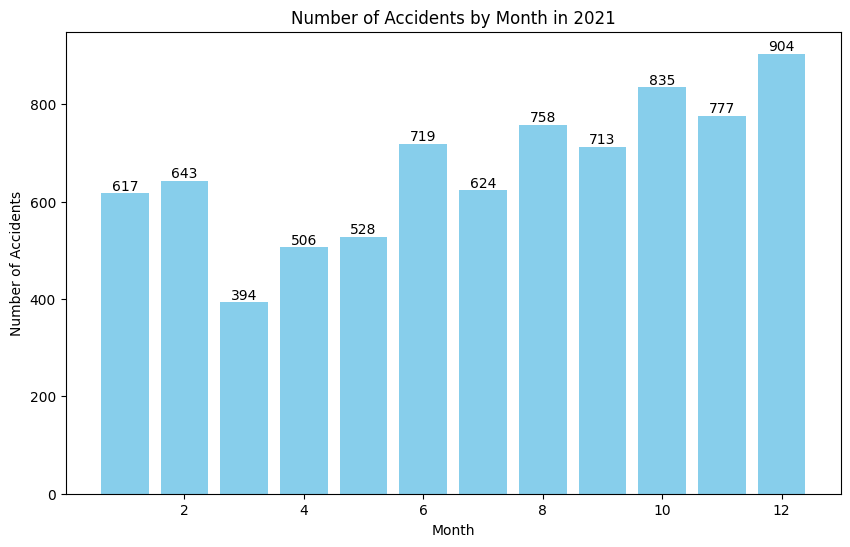

In [27]:
accidents_SWPA.Start_Time = pd.to_datetime(accidents_SWPA.Start_Time, format="ISO8601")
accidents_SWPA['Year'] = accidents_SWPA['Start_Time'].dt.year
accidents_SWPA['Month'] = accidents_SWPA['Start_Time'].dt.month
accidents_2021 = accidents_SWPA[accidents_SWPA['Year'] == 2021]
accidents_by_month = accidents_2021.groupby('Month').size()
plt.figure(figsize=(10, 6))
bars = plt.bar(accidents_by_month.index, accidents_by_month.values, color='skyblue')
plt.title('Number of Accidents by Month in 2021')
plt.xlabel('Month')
plt.ylabel('Number of Accidents')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.05, yval, ha='center', va='bottom')
plt.show()


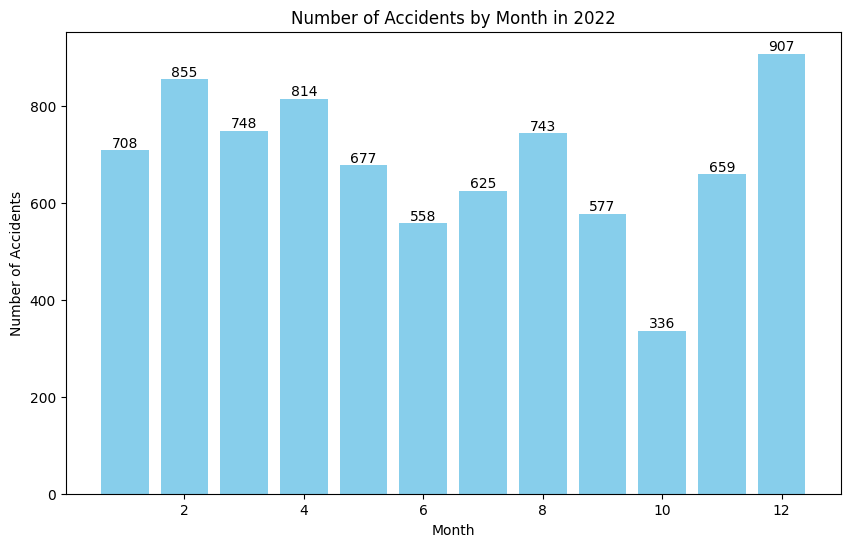

In [30]:
accidents_SWPA.Start_Time = pd.to_datetime(accidents_SWPA.Start_Time, format="ISO8601")
accidents_SWPA['Year'] = accidents_SWPA['Start_Time'].dt.year
accidents_SWPA['Month'] = accidents_SWPA['Start_Time'].dt.month
accidents_2022 = accidents_SWPA[accidents_SWPA['Year'] == 2022]
accidents_by_month = accidents_2022.groupby('Month').size()
plt.figure(figsize=(10, 6))
bars = plt.bar(accidents_by_month.index, accidents_by_month.values, color='skyblue')
plt.title('Number of Accidents by Month in 2022')
plt.xlabel('Month')
plt.ylabel('Number of Accidents')
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.05, yval, ha='center', va='bottom')
plt.show()

### Insight-5: Sudden increases of # accidents from 2020 to 2021

references: https://www.kaggle.com/code/satyabrataroy/60-insights-extraction-us-accident-analysis/notebook

In [4]:
US = accident_data.copy()

#### Visualize the road accidents percentage

In [115]:
# drop the data in 2023 as it is incomplete
US['Year'] = US.Start_Time.dt.year
US['Month'] = US.Start_Time.dt.month
US = US[US.Year != 2023]
print(US['Year'].value_counts().sort_index())
print('Number of accidents in the US from 2016 to 2022:', len(US))

Year
2016     410821
2017     718093
2018     893426
2019     954303
2020    1178913
2021    1563753
2022    1762452
Name: count, dtype: int64
Number of accidents in the US from 2016 to 2022: 7481761


In [116]:
# extract the data of Southwestern Pennsylvania, Pittsburgh seperately
SWPA = US[(US['State'] == 'PA') & (US['County'].isin(['Allegheny','Armstrong','Beaver','Butler','Fayette','Greene','Indiana','Lawrence','Washington','Westmoreland']))]
Pittsburgh = SWPA[SWPA['City'] == 'Pittsburgh']
print('Number of accidents in Southwestern Pennsylvania from 2016 to 2022:', len(SWPA))
print('Number of accidents in Pittsburgh from 2016 to 2022:', len(Pittsburgh))

Number of accidents in Southwestern Pennsylvania from 2016 to 2022: 31582
Number of accidents in Pittsburgh from 2016 to 2022: 13354


In [117]:
# define a plot function to visualize the number of accidents by year
import matplotlib.patches as mpatches
def year_percent(total_dataset, year_dataset, min_axes, max_axes, start_year, end_year, area):
    fig, ax = plt.subplots(figsize = (12,6), dpi = 80)

    ax=sns.barplot(y=year_dataset['Cases'], x=year_dataset['Year'], palette=['#9a90e8', '#5d82de', '#3ee6e0', '#40ff53','#2ee88e'])

    total = total_dataset.shape[0]
    for i in ax.patches:
        ax.text(i.get_x()+0.2, i.get_height()-max_axes*0.03, \
                str(round((i.get_height()/total)*100, 2))+'%', fontsize=10,weight='bold',
                    color='white')

    plt.ylim(min_axes, max_axes)
    plt.title(f'\nRoad Accident Percentage \nfrom {start_year} to {end_year} in {area}\n', size=20, color='grey')
    plt.ylabel('\nAccident Cases\n', fontsize=15, color='grey')
    plt.xlabel('\nYears\n', fontsize=15, color='grey')
    plt.xticks(fontsize=13)
    plt.yticks(fontsize=12)
    for i in ['bottom', 'top', 'left', 'right']:
        ax.spines[i].set_color('white')
        ax.spines[i].set_linewidth(1.5)
        

    for k in ['top', 'right', "bottom", 'left']:
            side = ax.spines[k]
            side.set_visible(False)

    ax.set_axisbelow(True)
    ax.grid(color='#b2d6c7', linewidth=1, axis='y', alpha=0.3)
    MA = mpatches.Patch(color='#2ee88e', label='Year with Maximum\n no. of Road Accidents')
    MI = mpatches.Patch(color='#9a90e8', label='Year with Minimum\n no. of Road Accidents')
    ax.legend(handles=[MA, MI], prop={'size': 10.5}, loc='best', borderpad=1, 
            labelcolor=['#2ee88e', '#9a90e8'], edgecolor='white')
    plt.show()

In [118]:
# count the number of accidents by year in the US, Southwestern Pennsylvania, and Pittsburgh
nums_US = US['Year'].value_counts().sort_index().reset_index().rename(columns={'Start_Time':'Year', 'count':'Cases'}).sort_values(by='Cases')
nums_SWPA = SWPA['Year'].value_counts().sort_index().reset_index().rename(columns={'Start_Time':'Year', 'count':'Cases'}).sort_values(by='Cases')
nums_Pitts = Pittsburgh['Year'].value_counts().sort_index().reset_index().rename(columns={'Start_Time':'Year', 'count':'Cases'}).sort_values(by='Cases')

In [119]:
# print out the boundary values for the y-axis
print('US:', nums_US['Cases'].min(), nums_US['Cases'].max())
print('SWPA:', nums_SWPA['Cases'].min(), nums_SWPA['Cases'].max())
print('Pittsburgh:', nums_Pitts['Cases'].min(), nums_Pitts['Cases'].max())

US: 410821 1762452
SWPA: 2076 8207
Pittsburgh: 984 3193


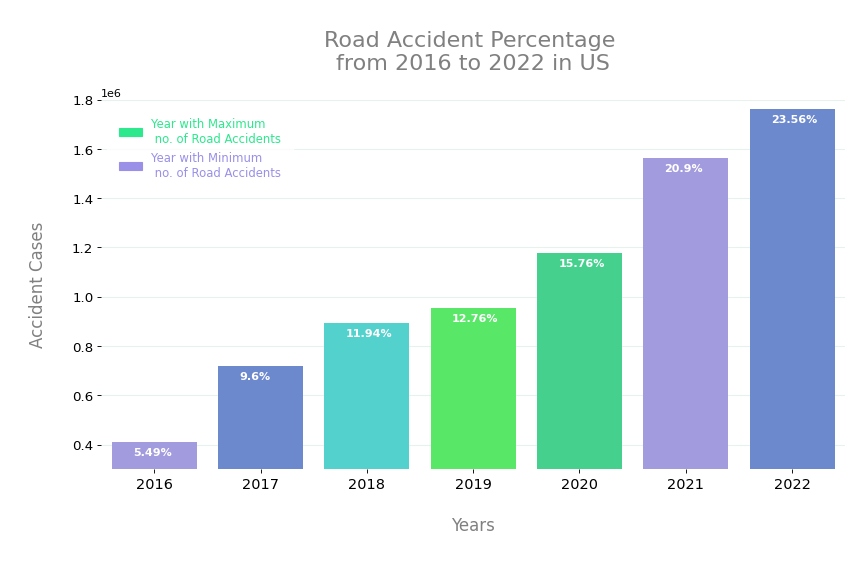

In [120]:
year_percent(US, nums_US, 300000, 1800000, 2016, 2022, 'US')


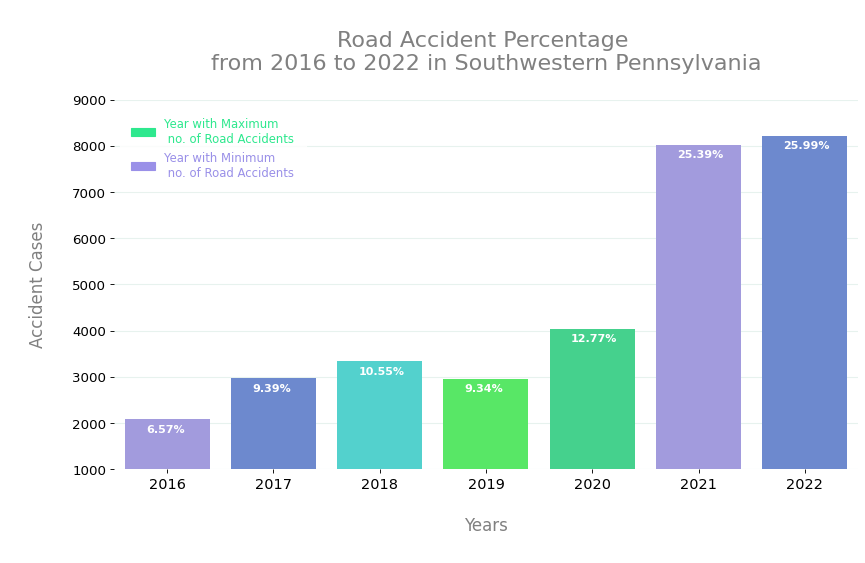

In [121]:
year_percent(SWPA, nums_SWPA, 1000, 9000, 2016, 2022, 'Southwestern Pennsylvania')

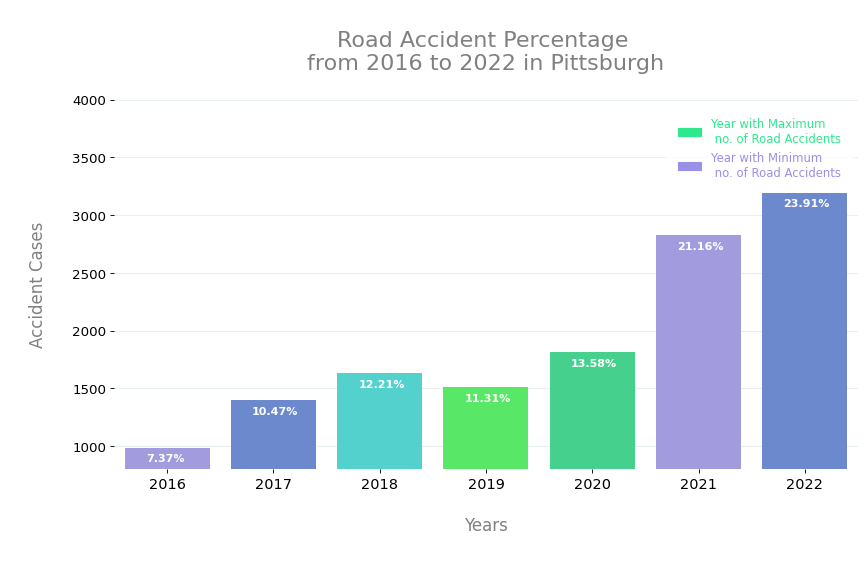

In [122]:
year_percent(Pittsburgh, nums_Pitts, 800, 4000, 2016, 2022, 'Pittsburgh')

In [123]:
# the result seems different from the kaggler's result - # of accidents suddenly increased in 2020
# check the number of accidents in the US from 2016 to 2020
US_1620 = US[US['Year'].isin([2016, 2017, 2018, 2019, 2020])]
nums_US_1620 = US_1620['Year'].value_counts().sort_index().reset_index().rename(columns={'Start_Time':'Year', 'count':'Cases'}).sort_values(by='Cases')
print('US_1620:', nums_US_1620['Cases'].min(), nums_US_1620['Cases'].max())

US_1620: 410821 1178913


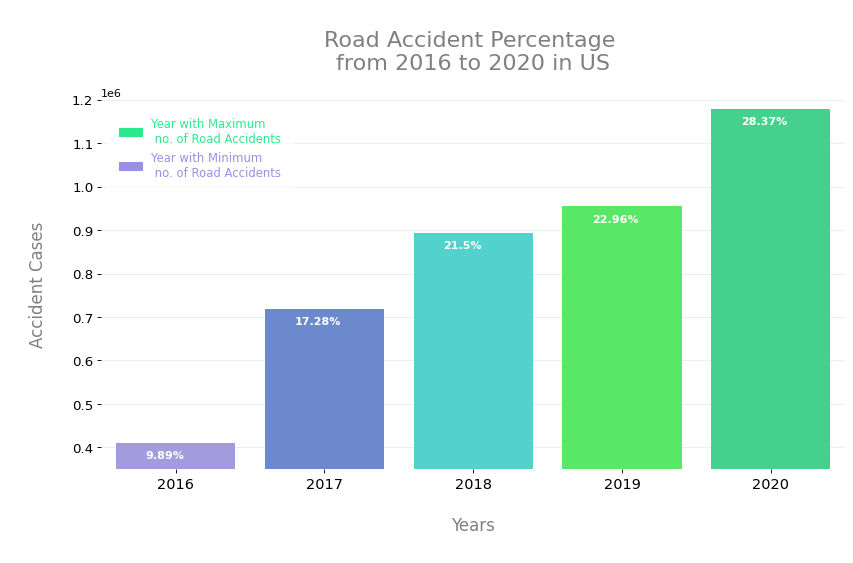

In [124]:
year_percent(US_1620, nums_US_1620, 350000, 1200000, 2016, 2020, 'US')

The dataset is updated? While there is a noticeable increase in the number of accidents from 2019 to 2020, the increase is not that steep.

#### Breakdown of the accidents by severity

In [125]:
def year_severity(area_data, min_axes,max_axes, severity_pivot, severity_percent, area):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(32, 10), dpi=80)

    # First subplot (Barplot with counts)
    sns.countplot(x='Year', hue='Severity', data=area_data, palette=['#9a90e8', '#5d82de', '#3ee6e0', '#2ee88e'], ax=ax1)
    ax1.set_xlabel('')
    ax1.set_ylabel('Count', fontsize=15, color='grey')
    ax1.set_ylim(min_axes, max_axes)
    ax1.set_xlabel('Year', fontsize=15, color='grey')
    handles, labels = ax2.get_legend_handles_labels()
    ax1.legend(handles[::-1], labels[::-1], title='Severity', loc='upper left', borderpad=0.5)
    for p in ax1.patches:
        ax1.annotate(int(p.get_height()), 
                    (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', 
                    xytext = (0, 10), textcoords = 'offset points')

    # Second subplot (Stacked bar plot with percentages)
    severity_percent.plot(kind='bar', stacked=True, color=['#9a90e8', '#5d82de', '#3ee6e0', '#2ee88e'], ax=ax2)
    for n, x in enumerate([*severity_pivot.index.values]):
        for (proportion, y_loc) in zip(severity_percent.loc[x], severity_percent.loc[x].cumsum()):
            if proportion > 0.01:
                ax2.text(x=n, y=(y_loc - proportion) + (proportion / 2), s=f'{proportion:.1%}', 
                        color="white", fontsize=10, weight='bold', ha='center', va='center')
    ax2.set_xlabel('Year', fontsize=15, color='grey')
    ax2.set_ylabel('Proportion', fontsize=15, color='grey')
    ax2.set_ylim(0, 1)
    handles, labels = ax2.get_legend_handles_labels()
    ax2.legend(handles[::-1], labels[::-1], title='Severity', loc='upper left', borderpad=0.5)

    for ax in [ax1, ax2]:
        ax.set_axisbelow(True)
        ax.grid(color='#b2d6c7', linewidth=1, axis='y', alpha=0.3)
        for spine in ax.spines.values():
            spine.set_visible(False)
    fig.suptitle(f'Severity Count by Year in {area}', size=28, color='grey')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [126]:
severity_cnt_US = US.pivot_table(index='Year', columns='Severity', aggfunc='size', fill_value=0)
severity_percent_US = severity_cnt_US.divide(severity_cnt_US.sum(axis=1), axis=0)
print('min:', severity_cnt_US.min().min(), 'max:', severity_cnt_US.max().max())

min: 151 max: 1603346


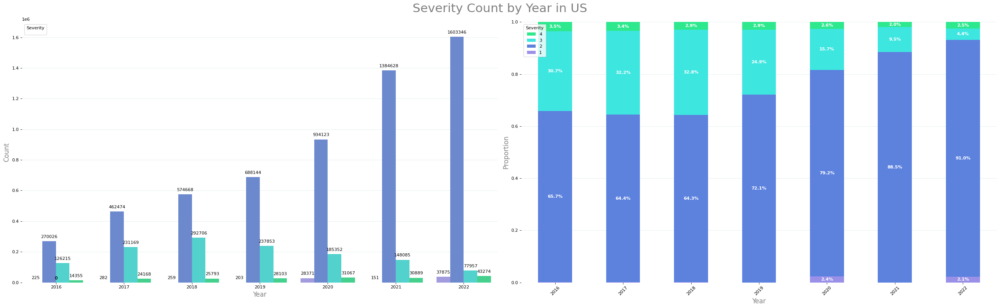

In [127]:
year_severity(US, 0, 1700000, severity_cnt_US, severity_percent_US, 'US')

In [128]:
severity_cnt_SWPA = SWPA.pivot_table(index='Year', columns='Severity', aggfunc='size', fill_value=0)
severity_percent_SWPA = severity_cnt_SWPA.divide(severity_cnt_SWPA.sum(axis=1), axis=0)
print('min:', severity_cnt_SWPA.min().min(), 'max:', severity_cnt_SWPA.max().max())

min: 0 max: 6663


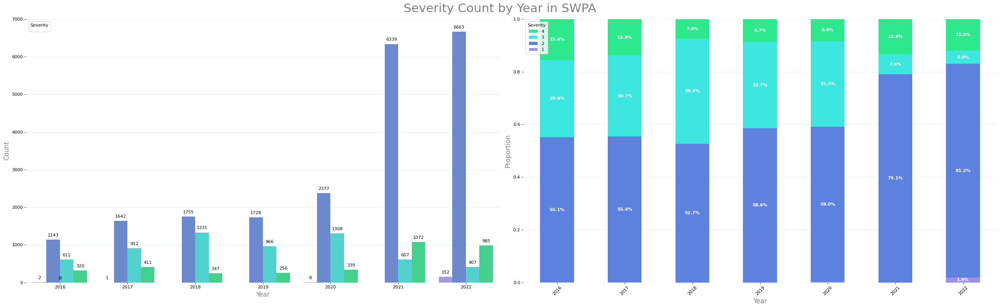

In [129]:
year_severity(SWPA, 0, 7000, severity_cnt_SWPA, severity_percent_SWPA, 'SWPA')

In [111]:
severity_cnt_Pitts = Pittsburgh.pivot_table(index='Year', columns='Severity', aggfunc='size', fill_value=0)
severity_percent_Pitts = severity_cnt_Pitts.divide(severity_cnt_Pitts.sum(axis=1), axis=0)
print('min:', severity_cnt_Pitts.min().min(), 'max:', severity_cnt_Pitts.max().max())

min: 0 max: 2655


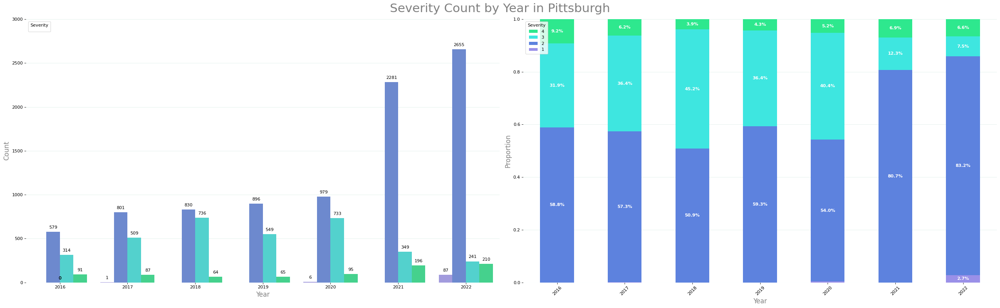

In [130]:
year_severity(Pittsburgh, 0, 3000, severity_cnt_Pitts, severity_percent_Pitts, 'Pittsburgh')

In [181]:
def month_severity(severity_month, severity_month_percent, min_axes, max_axes, area):
    fig, ax = plt.subplots(figsize = (10,8), dpi = 80)
    ax = severity_month_percent.plot(kind='bar', stacked=True, color=['#9a90e8', '#5d82de', '#3ee6e0', '#2ee88e'])
    for n, x in enumerate([*severity_month.index.values]):
        for (proportion, y_loc) in zip(severity_month.loc[x], severity_month.loc[x].cumsum()):
            if proportion > 0.01:
                ax.text(x=n, y=(y_loc - proportion) + (proportion / 2), s=f'{proportion:.1%}', 
                        color="white", fontsize=10, weight='bold', ha='center', va='center')
    ax.set_xlabel('Month', fontsize=15, color='grey')
    ax.set_ylabel('Proportion', fontsize=15, color='grey')
    ax.set_ylim(min_axes, max_axes)
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles[::-1], labels[::-1], title='Severity', loc='upper left', borderpad=0.5)
    ax.set_axisbelow(True)
    ax.grid(color='#b2d6c7', linewidth=1, axis='y', alpha=0.3)
    # for spine in ax.spines.values(): spine.set_visible(False)
    fig.suptitle(f'Severity Count by Month in 2020 in {area}', size=28, color='grey')
    plt.xticks(rotation=45)
    plt.show()

In [179]:
US_20 = US[US['Year'] == 2020]
severity_US20 = US_20.pivot_table(index='Month', columns='Severity', aggfunc='size', fill_value=0)
severity_percent_US20 = severity_US20.divide(severity_US20.sum(axis=1), axis=0)
print('min:', severity_US20.min().min(), 'max:', severity_US20.max().max())

min: 6 max: 163600


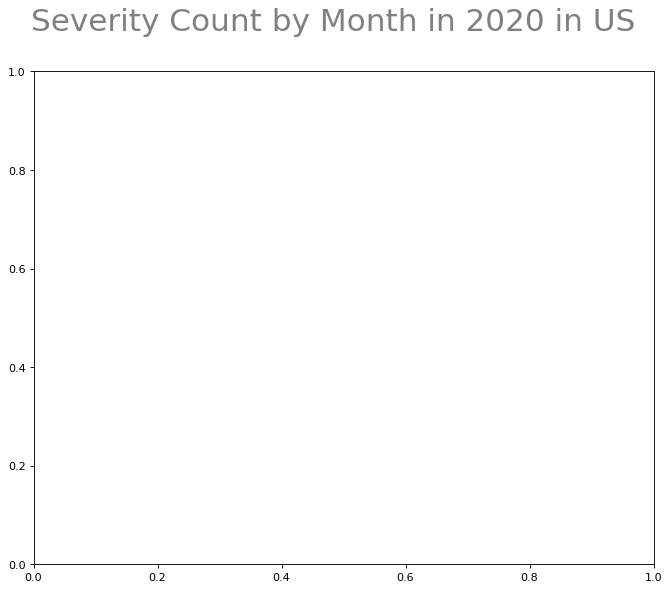

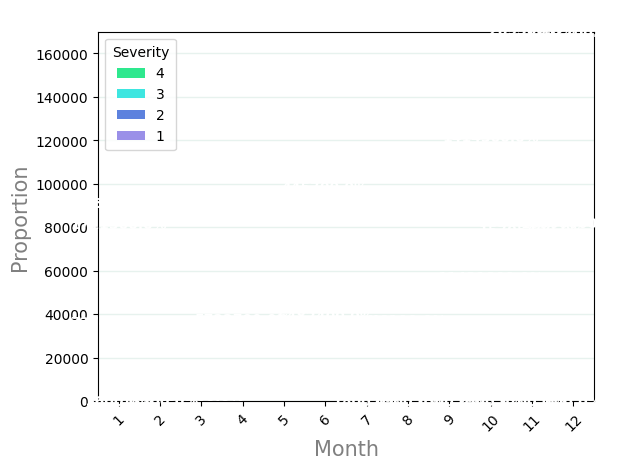

In [182]:
month_severity(severity_US20, severity_percent_US20, 0, 170000, 'US')

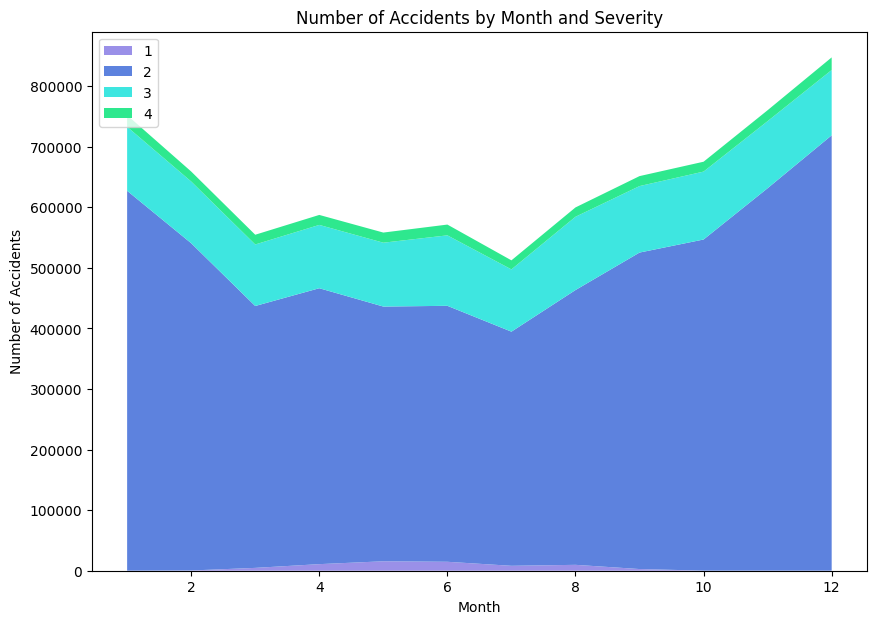

In [57]:
# Convert the 'Start_Time' column to datetime
accident_data['Start_Time'] = pd.to_datetime(accident_data['Start_Time'])

# Create a new column for the month
accident_data['Month'] = accident_data['Start_Time'].dt.month

# Group by month and severity
grouped = accident_data.groupby(['Month', 'Severity']).size().unstack()

# Plot
plt.figure(figsize=(10,7))
plt.stackplot(grouped.index, grouped.T, labels=grouped.columns, colors=['#9a90e8', '#5d82de', '#3ee6e0', '#2ee88e'])
plt.legend(loc='upper left')
plt.xlabel('Month')
plt.ylabel('Number of Accidents')
plt.title('Number of Accidents by Month and Severity')
plt.show()


## Geospatial Maps

In [31]:
#import libraries
import geopandas as gpd
import geoplot as gplt
import geoplot.crs as gcrs
import folium
from folium.plugins import MarkerCluster
import random

In [32]:
#create dataframe of variables I'm interested in looking at on a map plus lat/lng variables
severity_locations = accidents_SWPA[['County','Severity','Start_Lng','Start_Lat']]

In [33]:
#create a GeoDataFrame
gdf_severity = gpd.GeoDataFrame(severity_locations, geometry=gpd.points_from_xy(severity_locations.Start_Lng, severity_locations.Start_Lat))

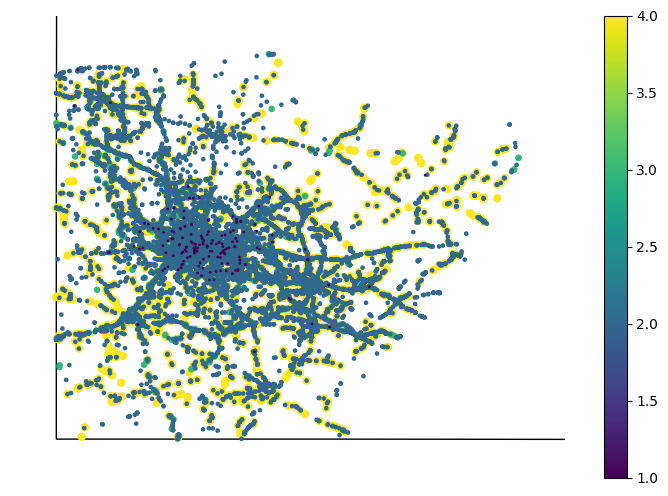

In [50]:
#generate map with hue based on severity
contiguous_usa = gpd.read_file(gplt.datasets.get_path('contiguous_usa'))
sw_penn = contiguous_usa[contiguous_usa['state'] == 'Pennsylvania']
ax = gplt.polyplot(
    sw_penn,
    figsize=(10, 6)
)
gplt.pointplot(
    gdf_severity,
    ax=ax,
    hue='Severity',
    scale='Severity',
    legend=True,
    legend_var='hue',
)
plt.show()

In [34]:
def create_map(df_loc, latitude, longitude, zoom, tiles='OpenStreetMap'):
    """
    Generate a Folium Map with clustered markers of accident locations.
    """
    world_map = folium.Map(location=[latitude, longitude], zoom_start=zoom, tiles=tiles)
    marker_cluster = MarkerCluster().add_to(world_map)

    # Iterate over the DataFrame rows and add each marker to the cluster
    for idx, row in df_loc.iterrows():
        folium.Marker(
            location=[row['Start_Lat'], row['Start_Lng']],
            popup=f"Lat, Lng: {row['Start_Lat']}, {row['Start_Lng']}, Start Time: {row['Start_Time']}"
        ).add_to(marker_cluster)

    return world_map

In [35]:
SWPA_coords = {"lat": 40.4406, "lon": -79.9959} # Coordinates for Pittsburgh, a central city in SWPA
map_ls = create_map(accidents_SWPA, 
                    SWPA_coords['lat'],
                    SWPA_coords['lon'], 
                    10,
                    tiles="cartodbpositron"
                   )
map_ls

## Data Cleaning and Feature Engineering

In [53]:
SWPA = accidents_SWPA.copy()
SWPA.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32819 entries, 228582 to 7727994
Data columns (total 46 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   ID                     32819 non-null  object        
 1   Source                 32819 non-null  object        
 2   Severity               32819 non-null  int64         
 3   Start_Time             32819 non-null  datetime64[ns]
 4   End_Time               32819 non-null  object        
 5   Start_Lat              32819 non-null  float64       
 6   Start_Lng              32819 non-null  float64       
 7   End_Lat                20026 non-null  float64       
 8   End_Lng                20026 non-null  float64       
 9   Distance(mi)           32819 non-null  float64       
 10  Description            32819 non-null  object        
 11  Street                 32754 non-null  object        
 12  City                   32819 non-null  object        
 13 

In [54]:
# Timestamp Tweaking
SWPA.End_Time = pd.to_datetime(accidents_SWPA.End_Time, format="ISO8601")
SWPA['Year']=SWPA['Start_Time'].dt.year
SWPA['Month']=SWPA['Start_Time'].dt.strftime('%b')
SWPA['Day']=SWPA['Start_Time'].dt.day
SWPA['Hour']=SWPA['Start_Time'].dt.hour
SWPA['Weekday']=SWPA['Start_Time'].dt.strftime('%a')
td='Time_Duration(min)'
SWPA[td]=round((SWPA['End_Time']-SWPA['Start_Time'])/np.timedelta64(1,'m'))

In [55]:
import missingno as mn
null_cols = [i for i in SWPA.columns if SWPA[i].isnull().any()]

In [56]:
mn.matrix(SWPA[null_cols])

<Axes: >

In [57]:
SWPA.drop(columns=['End_Lat', 'End_Lng', 'Wind_Chill(F)', 'Precipitation(in)'], inplace=True)
# drop rows without street, Weather_Condition, Wind_Direction
# based on insight 3, drop rows with nan airport code
# also drop the rows without period of day info
SWPA = SWPA.dropna(subset=['Street', 'Airport_Code', 'Weather_Timestamp', 'Wind_Direction', 'Weather_Condition', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight', 'Astronomical_Twilight'])

SWPA["Temperature(F)"] = SWPA['Temperature(F)'].fillna(SWPA['Temperature(F)'].mean())
SWPA["Humidity(%)"] = SWPA['Humidity(%)'].fillna(SWPA['Humidity(%)'].mean())
SWPA["Pressure(in)"] = SWPA['Pressure(in)'].fillna(SWPA['Pressure(in)'].mean())
SWPA["Visibility(mi)"] = SWPA['Visibility(mi)'].fillna(SWPA['Visibility(mi)'].mean())
SWPA["Wind_Speed(mph)"] = SWPA['Wind_Speed(mph)'].fillna(SWPA['Wind_Speed(mph)'].mean())

In [58]:
SWPA.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32211 entries, 228582 to 7727994
Data columns (total 48 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   ID                     32211 non-null  object        
 1   Source                 32211 non-null  object        
 2   Severity               32211 non-null  int64         
 3   Start_Time             32211 non-null  datetime64[ns]
 4   End_Time               32211 non-null  datetime64[ns]
 5   Start_Lat              32211 non-null  float64       
 6   Start_Lng              32211 non-null  float64       
 7   Distance(mi)           32211 non-null  float64       
 8   Description            32211 non-null  object        
 9   Street                 32211 non-null  object        
 10  City                   32211 non-null  object        
 11  County                 32211 non-null  object        
 12  State                  32211 non-null  object        
 13 

In [59]:
# Dropping unnecessary columns
SWPA.drop(columns =['ID', 'State', 'Country', 'Timezone', 'Description'],inplace = True)

In [60]:
categorical_cols = SWPA.select_dtypes(include=['object'])
categorical_cols.nunique()

Source                       3
Street                    4123
City                       268
County                      10
Zipcode                   5895
Airport_Code                14
Weather_Timestamp        17859
Wind_Direction              24
Weather_Condition           55
Sunrise_Sunset               2
Civil_Twilight               2
Nautical_Twilight            2
Astronomical_Twilight        2
Month                       12
Weekday                      7
dtype: int64

In [61]:
# binning categorical columns

# Weather_Condition
weather_bins = {
    'Clear': ['Clear', 'Fair'],
    'Cloudy': ['Cloudy', 'Mostly Cloudy', 'Partly Cloudy', 'Scattered Clouds'],
    'Rainy': ['Light Rain', 'Rain', 'Light Freezing Drizzle', 'Light Drizzle', 'Heavy Rain', 'Light Freezing Rain', 'Drizzle', 'Light Freezing Fog', 'Light Rain Showers', 'Showers in the Vicinity', 'T-Storm', 'Thunder', 'Patches of Fog', 'Heavy T-Storm', 'Heavy Thunderstorms and Rain', 'Funnel Cloud', 'Heavy T-Storm / Windy', 'Heavy Thunderstorms and Snow', 'Rain / Windy', 'Heavy Rain / Windy', 'Squalls', 'Heavy Ice Pellets', 'Thunder / Windy', 'Drizzle and Fog', 'T-Storm / Windy', 'Smoke / Windy', 'Haze / Windy', 'Light Drizzle / Windy', 'Widespread Dust / Windy', 'Wintry Mix', 'Wintry Mix / Windy', 'Light Snow with Thunder', 'Fog / Windy', 'Snow and Thunder', 'Sleet / Windy', 'Heavy Freezing Rain / Windy', 'Squalls / Windy', 'Light Rain Shower / Windy', 'Snow and Thunder / Windy', 'Light Sleet / Windy', 'Sand / Dust Whirlwinds', 'Mist / Windy', 'Drizzle / Windy', 'Duststorm', 'Sand / Dust Whirls Nearby', 'Thunder and Hail', 'Freezing Rain / Windy', 'Light Snow Shower / Windy', 'Partial Fog', 'Thunder / Wintry Mix / Windy', 'Patches of Fog / Windy', 'Rain and Sleet', 'Light Snow Grains', 'Partial Fog / Windy', 'Sand / Dust Whirlwinds / Windy', 'Heavy Snow with Thunder', 'Heavy Blowing Snow', 'Low Drifting Snow', 'Light Hail', 'Light Thunderstorm', 'Heavy Freezing Drizzle', 'Light Blowing Snow', 'Thunderstorms and Snow', 'Heavy Rain Showers', 'Rain Shower / Windy', 'Sleet and Thunder', 'Heavy Sleet and Thunder', 'Drifting Snow / Windy', 'Shallow Fog / Windy', 'Thunder and Hail / Windy', 'Heavy Sleet / Windy', 'Sand / Windy', 'Heavy Rain Shower / Windy', 'Blowing Snow Nearby', 'Blowing Sand', 'Heavy Rain Shower', 'Drifting Snow', 'Heavy Thunderstorms with Small Hail'],
    'Snowy': ['Light Snow', 'Snow', 'Light Snow / Windy', 'Snow Grains', 'Snow Showers', 'Snow / Windy', 'Light Snow and Sleet', 'Snow and Sleet', 'Light Snow and Sleet / Windy', 'Snow and Sleet / Windy'],
    'Windy': ['Blowing Dust / Windy', 'Fair / Windy', 'Mostly Cloudy / Windy', 'Light Rain / Windy', 'T-Storm / Windy', 'Blowing Snow / Windy', 'Freezing Rain / Windy', 'Light Snow and Sleet / Windy', 'Sleet and Thunder / Windy', 'Blowing Snow Nearby', 'Heavy Rain Shower / Windy'],
    'Hail': ['Hail'],
    'Volcanic Ash': ['Volcanic Ash'],
    'Tornado': ['Tornado']
}
def map_weather_to_bins(weather):
    for bin_name, bin_values in weather_bins.items():
        if weather in bin_values:
            return bin_name
    return 'Other' 
SWPA['Weather_Condition'] = SWPA['Weather_Condition'].apply(map_weather_to_bins)
SWPA.drop(columns=['Weather_Condition'], inplace=True)

# Other Weather info
SWPA['Temperature_Category'] = pd.cut(SWPA['Temperature(F)'], bins=[-100, 50, 80, 200], labels=['Cold', 'Mild', 'Hot'])
SWPA['Humidity_Level'] = pd.cut(SWPA['Humidity(%)'], bins=[0, 30, 70, 100], labels=['Low', 'Moderate', 'High'])
SWPA['Pressure_Category'] = pd.cut(SWPA['Pressure(in)'], bins=[0, 29.5, 30.2, 100], labels=['Low', 'Normal', 'High'])
SWPA['Visibility_Category'] = pd.cut(SWPA['Visibility(mi)'], bins=[0, 1, 5, 100], labels=['Poor', 'Moderate', 'Clear'])
SWPA.drop(columns=['Temperature(F)','Humidity(%)','Pressure(in)','Visibility(mi)'], inplace = True)

# Wind_Dirrection
def bin_wind_direction(direction):
    if direction in ['N', 'NNE', 'NNW', 'North']:
        return 'North'
    elif direction in ['E', 'ENE', 'ESE', 'East']:
        return 'East'
    elif direction in ['S', 'SSE', 'SSW', 'South']:
        return 'South'
    elif direction in ['W', 'WNW', 'WSW', 'West']:
        return 'West'
    elif direction in ['Calm', 'Variable', 'CALM', 'VAR']:
        return 'Calm/Variable'
    else:
        return direction
SWPA['Wind_Direction'] = SWPA['Wind_Direction'].apply(bin_wind_direction)

In [62]:
for col in SWPA.columns:
    print('{}: {}'.format(col,SWPA[col].unique()))

Source: ['Source2' 'Source3' 'Source1']
Severity: [3 2 1 4]
Start_Time: <DatetimeArray>
['2016-11-30 18:03:36', '2016-11-30 19:15:33', '2016-11-30 20:35:53',
 '2016-12-01 06:30:39', '2016-12-01 07:18:46', '2016-12-01 07:32:48',
 '2016-12-01 07:49:10', '2016-12-01 07:53:27', '2016-12-01 07:58:12',
 '2016-12-01 07:55:13',
 ...
 '2019-08-05 03:50:25', '2019-08-05 13:59:36', '2019-08-05 17:53:47',
 '2019-08-09 13:56:44', '2019-08-09 15:22:58', '2019-08-11 02:20:25',
 '2019-08-11 08:18:56', '2019-08-19 11:06:07', '2019-08-20 10:57:28',
 '2019-08-23 03:34:00']
Length: 22918, dtype: datetime64[ns]
End_Time: <DatetimeArray>
['2016-11-30 18:33:11', '2016-11-30 19:45:06', '2016-11-30 21:05:08',
 '2016-12-01 07:00:18', '2016-12-01 07:48:31', '2016-12-01 08:02:32',
 '2016-12-01 08:18:57', '2016-12-01 08:22:53', '2016-12-01 08:28:00',
 '2016-12-01 08:25:00',
 ...
 '2019-08-05 04:19:04', '2019-08-05 14:28:13', '2019-08-05 18:22:45',
 '2019-08-09 18:46:32', '2019-08-09 15:51:44', '2019-08-11 02:48:32

In [63]:
SWPA.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32211 entries, 228582 to 7727994
Data columns (total 42 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   Source                 32211 non-null  object        
 1   Severity               32211 non-null  int64         
 2   Start_Time             32211 non-null  datetime64[ns]
 3   End_Time               32211 non-null  datetime64[ns]
 4   Start_Lat              32211 non-null  float64       
 5   Start_Lng              32211 non-null  float64       
 6   Distance(mi)           32211 non-null  float64       
 7   Street                 32211 non-null  object        
 8   City                   32211 non-null  object        
 9   County                 32211 non-null  object        
 10  Zipcode                32211 non-null  object        
 11  Airport_Code           32211 non-null  object        
 12  Weather_Timestamp      32211 non-null  object        
 13 

In [64]:
categorical_cols = SWPA.select_dtypes(include=['object'])
categorical_cols.nunique()

Source                       3
Street                    4123
City                       268
County                      10
Zipcode                   5895
Airport_Code                14
Weather_Timestamp        17859
Wind_Direction               9
Sunrise_Sunset               2
Civil_Twilight               2
Nautical_Twilight            2
Astronomical_Twilight        2
Month                       12
Weekday                      7
dtype: int64

### Possible statistic/ML models:
- LSTM: predict accident locations on unseen data. (how to split the area)
- Clustering geographical coordinates
- Text Segmentation: Predicting accident severity based on Description Provided

## WSDOT

In [27]:
import datetime
import re

def parse_microsoft_json_date(json_date):
    """
    Converts Microsoft JSON date format "/Date(928174800000-0700)/" to Python datetime.
    """
    if not isinstance(json_date, str):
        return None 
    match = re.match(r'/Date\((\d+)([+-]\d{4})\)/', json_date)
    if match:
        timestamp = int(match.group(1)) / 1000  # convert from milliseconds to seconds
        timezone_offset = int(match.group(2))  # in the format of "+0700" or "-0700"
        
        date = datetime.datetime.utcfromtimestamp(timestamp)
        offset_hours = timezone_offset // 100  # extract hours
        offset_minutes = timezone_offset % 100  # extract minutes
        delta = datetime.timedelta(hours=offset_hours, minutes=offset_minutes)
        local_date = date + delta
        
        return local_date
    else:
        raise ValueError("Invalid date format")

In [47]:
import requests

ACCESSCODE = '493a94c5-6fb5-45cb-88f5-29c396d55a87'
# url = f'http://wsdot.wa.gov/Traffic/api/BorderCrossings/BorderCrossingsREST.svc/GetBorderCrossingsAsJson?AccessCode={ACCESSCODE}'
# url = f'http://wsdot.wa.gov/Traffic/api/CVRestrictions/CVRestrictionsREST.svc/GetCommercialVehicleRestrictionsAsJson?AccessCode={ACCESSCODE}'
# url = f'http://wsdot.wa.gov/Traffic/api/TollRates/TollRatesREST.svc/GetTollRatesAsJson?AccessCode={ACCESSCODE}'
# url = f'http://wsdot.wa.gov/Traffic/api/TrafficFlow/TrafficFlowREST.svc/GetTrafficFlowsAsJson?AccessCode={ACCESSCODE}'
node_id = '68'
url = f'https://api.openstreetmap.org/api/0.6/node/{node_id}'
response = requests.get(url)

if response.status_code == 200:
    # border_data = response.json()
    # cvr_data = response.json()
    # toll_data = response.json()
    open_data = response.json()
else:
    print(f'Failed to retrieve data: {response.status_code}')

Failed to retrieve data: 410


In [19]:
import pandas as pd
cvr_df = pd.DataFrame(cvr_data)
date_columns = ['DateEffective', 'DateExpires', 'DatePosted']
for column in date_columns:
    cvr_df[f'Parsed{column}'] = cvr_df[column].apply(parse_microsoft_json_date)
cvr_df.head()

(340, 29)


,BLMaxAxle,BridgeName,BridgeNumber,CL8MaxAxle,DateEffective,DateExpires,DatePosted,EndRoadwayLocation,IsDetourAvailable,IsExceptionsAllowed,...,RestrictionLengthInInches,RestrictionType,RestrictionWeightInPounds,RestrictionWidthInInches,SAMaxAxle,StartRoadwayLocation,State,StateRouteID,TDMaxAxle,VehicleType
0,20000.0,Teanaway River,10/142,20000.0,/Date(1318921200000-0700)/,/Date(3345004800000-0800)/,/Date(1318975920000-0700)/,"{'Description': None, 'Direction': 'Both', 'La...",False,False,...,0.0,0,0.0,0.0,40000.0,"{'Description': None, 'Direction': 'Both', 'La...",WA,10,NaN,
1,0.0,,,0.0,/Date(1382598000000-0700)/,/Date(1382598000000-0700)/,/Date(1382655540000-0700)/,"{'Description': None, 'Direction': 'Both', 'La...",False,False,...,NaN,1,NaN,NaN,0.0,"{'Description': None, 'Direction': 'Both', 'La...",WA,10,0.0,
2,20000.0,Greenhead Slough,101/18,20000.0,/Date(1318921200000-0700)/,/Date(3345004800000-0800)/,/Date(1409092980000-0700)/,"{'Description': None, 'Direction': 'Both', 'La...",False,False,...,0.0,0,0.0,0.0,38000.0,"{'Description': None, 'Direction': 'Both', 'La...",WA,101,NaN,
3,21500.0,South Nemah R No 2,101/27,NaN,/Date(1318921200000-0700)/,/Date(3345004800000-0800)/,/Date(1409091660000-0700)/,"{'Description': None, 'Direction': 'Both', 'La...",False,False,...,0.0,0,0.0,0.0,40000.0,"{'Description': None, 'Direction': 'Both', 'La...",WA,101,NaN,
4,18000.0,South Nemah R No 1,101/29,18000.0,/Date(1271919600000-0700)/,/Date(3345004800000-0800)/,/Date(1271975820000-0700)/,"{'Description': None, 'Direction': 'Both', 'La...",False,False,...,0.0,0,0.0,0.0,NaN,"{'Description': None, 'Direction': 'Both', 'La...",WA,101,NaN,


In [35]:
toll_df = pd.DataFrame(toll_data)
toll_df['TimeUpdated'] = toll_df['TimeUpdated'].apply(parse_microsoft_json_date)
print(toll_df.shape)
toll_df

(48, 14)


,CurrentMessage,CurrentToll,EndLatitude,EndLocationName,EndLongitude,EndMilepost,StartLatitude,StartLocationName,StartLongitude,StartMilepost,StateRoute,TimeUpdated,TravelDirection,TripName
0,None,150,47.587649,NB S Portal,-122.338772,30.00,47.626666,SB S Portal,-122.343652,33.00,099,2024-04-16 10:53:58.940,S,099tp03268
1,None,350,47.626666,SB S Portal,-122.343652,33.00,47.587649,NB S Portal,-122.338772,30.00,099,2024-04-16 10:53:58.940,S,099tp03060
2,None,100,47.704185,NE 128th,-122.179840,19.86,47.819422,SR 524,-122.241634,28.96,405,2024-04-16 10:53:58.940,S,405tp02896
3,None,100,47.678796,NE 85th,-122.184710,18.09,47.819422,SR 524,-122.241634,28.96,405,2024-04-16 10:53:58.940,S,405tp02897
4,None,100,47.615598,NE 6th,-122.188485,13.70,47.819422,SR 524,-122.241634,28.96,405,2024-04-16 10:53:58.940,S,405tp02898
5,None,100,47.704185,NE 128th,-122.179840,19.86,47.806303,216th ST SE,-122.228207,27.82,405,2024-04-16 10:53:58.940,S,405tp02782
6,None,100,47.678796,NE 85th,-122.184710,18.09,47.806303,216th ST SE,-122.228207,27.82,405,2024-04-16 10:53:58.940,S,405tp02783
7,None,100,47.615598,NE 6th,-122.188485,13.70,47.806303,216th ST SE,-122.228207,27.82,405,2024-04-16 10:53:58.940,S,405tp02784
8,None,100,47.822720,I-5,-122.248468,29.35,47.802730,216th SE,-122.225179,27.52,405,2024-04-16 10:53:58.940,N,405tp02752
9,None,100,47.271956,Ellingson Rd,-122.259461,12.20,47.458639,S 23rd St,-122.216956,25.64,167,2024-04-16 10:53:58.940,S,167tp02564


In [45]:
tf_df = pd.DataFrame(tf_data)
tf_df['Time'] = tf_df['Time'].apply(parse_microsoft_json_date)
tf_df = tf_df.join(tf_df['FlowStationLocation'].apply(pd.Series))
tf_df.drop(columns=['FlowStationLocation'], inplace=True)
tf_df.head()

,FlowDataID,FlowReadingValue,Region,StationName,Time,Description,Direction,Latitude,Longitude,MilePost,RoadName
0,2482,1,Northwest,002es00068,2024-04-16 10:56:22,Homeacres Rd,EB,47.978416,-122.174702,0.68,002
1,6563,1,Olympic,002es00068,2024-04-16 10:55:22,Unknown,EB,47.978416,-122.174703,0.68,002
2,6564,1,Olympic,002es00068,2024-04-16 10:55:22,Unknown,WB,47.978236,-122.176069,0.68,002
3,2483,1,Northwest,002es00068,2024-04-16 10:56:22,Homeacres Rd,WB,47.978235,-122.175402,0.68,002
4,4828,1,Northwest,002es00360,2024-04-16 10:56:22,"Bickford Ave, WB",EB,47.963102,-122.124999,3.60,002


# References
- https://www.kaggle.com/code/michaelbryantds/eda-of-vehicle-accident-data